<a href="https://colab.research.google.com/github/ar961na/dbms2024/blob/main/tds.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Подготовка

In [ ]:
# @title
from math import *
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
import matplotlib.animation as animation
from IPython.display import Image

In [ ]:
# @title
from matplotlib import rc
rc('animation', html='jshtml')

# Нелинейные колебания. Фазовые портреты колебательных систем

## **Глава 1: 34**

Шарик массы может колебаться в невесомости на пружине, зависимость упругой силы которой от деформации имеет вид
$F=kx+cx^3$
где k и c - положительные коэффициенты.

​Постройте фазовый портрет системы. В чем его отличие от фазового портрета соответствующей линейной системы?

Укажите область на фазовой плоскости, в пределах которой систему можно считать линейной.

### Решение

$F=kx+cx^3$

$𝛱=\frac{1}{2}kx^2+\frac{1}{4}cx^4$

$F=∇𝛱$

При $с=0$ - линейный гармонический осцилятор, центр.
Система консервативна (ЗСЭ).

$E=T+𝛱$

$T = \frac{mx'^2}{2}$

При $x<<\sqrt{\frac{k}{c}}$ - влиянием нелинейной части можно пренебречь.

### Код

In [ ]:
# @title
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import interact, FloatSlider

# Определение функции для вычисления производных
def dF(x, v, k, c):
    m = 1
    return v, -(k * x + c * x ** 3) / m

# Создание функции для отображения фазового портрета
def plot_phase_portrait(k, c):
    X, V = np.meshgrid(np.linspace(-3.0, 3.0, 30), np.linspace(-3.0, 3.0, 30))
    dX, dV = dF(X, V, k, c)

    plt.figure(figsize=(8, 6))
    plt.streamplot(X, V, dX, dV, color='r', linewidth=0.5, density=1.6)
    plt.xlabel('x')
    plt.ylabel('v')
    plt.title('Phase Portrait')
    plt.xlim(-3, 3)
    plt.ylim(-3, 3)
    plt.grid(True)
    plt.gca().set_aspect('equal', adjustable='box')
    plt.show()

# Создание интерактивных элементов управления
k_slider = FloatSlider(value=1.0, min=0, max=1.0, step=0.1, description='k:')
c_slider = FloatSlider(value=0.0, min=0, max=1.0, step=0.1, description='c:')
interact(plot_phase_portrait, k=k_slider, c=c_slider)

interactive(children=(FloatSlider(value=1.0, description='k:', max=1.0), FloatSlider(value=0.0, description='c…

<function __main__.plot_phase_portrait(k, c)>

## **Глава 1: 51**

Найдите поправку к частоте линейных колебаний для математического маятника.

Покажите, что в первом порядке по квадрату амплитуды полученная оценка согласуется с известным результатом, отвечающим аппроксимации математического маятника осциллятором с кубической нелинейностью. Оцените период колебаний с угловой амплитудой π/2.

Сравните найденное значение с точным и оценкой для осциллятора с кубической нелинейностью.

*(Указание. Используйте формулу для разложения функции sin(x sin 0) в ряд по функциям Бесселя.)*

Решение в конце.

# Динамические системы и бифуркации

## **Глава 3: 89** *Эволюция облака изображающих точек в фазовом пространстве для потоковых систем.*

Задайте облако изображающих точек в фазовом пространстве в виде прямоугольной "решетки" из набора точек.

Напишите программу, позволяющую наблюдать за эволюцией этого облака во времени для представленного ниже осциллятора Ван дер Поля. Проследите за эволюцией облака.

Ответьте на вопросы: консервативная или диссипативная система? Есть ли в ней аттракторы? Какого типа эти аттракторы? Проведите компьютерное моделирование для различных значений параметров. Изменяется ли при этом характер эволюции облака? Что происходит с аттракторами? Попробуйте изменить форму облака и его начальное положение.

  $x''-(λ-x^2)x'+x=0$

### Теория

Перепишем его в виде системы уравнений первого порядка:

$x'=f_{1}(x,y,λ)$

$у'=f_{2}(x,у,λ)$

$f_{1}(х,у,λ)=у$

$f_{2}(x,y,λ)=(λ-х^2)у-х$

Запишем уравнения для состояний равновесия, приравняв нулю функ­ции $f_{1}$ и $f_{2}$:

$у=0$

$(λ-х^2)у-х=0$

Видно, что существует единственная особая точка,расположенная на фазо­вой плоскости в начале координат: $х^0=0, у^0=0$.

Как было показано ранее, для определения устойчивости состояния равновесия следует линеаризовать систему в окрестности неподвижной точки, построить матрицу линеаризации (матрицу Якоби):

$A(x^0, y^0) =
\begin{pmatrix}
  \frac{δf_{1}(x^0, y^0)}{δx} & \frac{δf_{1}(x^0, y^0)}{δy} \\
  \frac{δf_{2}(x^0, y^0)}{δx} & \frac{δf_{2}(x^0, y^0)}{δy}
\end{pmatrix} =
\begin{pmatrix}
  0 & 1 \\
  -1 & λ
\end{pmatrix}$

Собственные значения матрицы определяют устойчивость состояния равновесия осциллятора Ван дер Поля. Их легко получить из характеристического уравнения

$Det
\begin{pmatrix}
  0-λ & 1 \\
  -1 & λ-s
\end{pmatrix} = 0$

$s^2 - λs + 1 = 0$

В результате получаем два собственных числа:

$s_{1, 2} = \frac{λ}{2} ± \sqrt{\frac{λ^2}{4} - 1}$

Проследим за устойчивостью состояния равновесия $(𝑥^0,𝑦^0)$ ос­циллятора Ван дер Поля в зависимости от управляющего параметра λ.

1.   При λ < -2 собственные значения $s_{1}$ и $s_{2}$ - действительные и
от­рицательные числа. В этом случае состояние равновесия представляет собой
устойчивый узел

2.   При -2 < λ < 0 собственные значения $s_{1}$ и $s_{2}$ - комплексно-сопря­женные числа и Re[$s_{1,2}$] < 0. Состояние равновесия - устойчивый фокус.

3.   При 0 < λ < 2 собственные значения $s_{1}$ и $s_{2}$ - комплексно-сопря­женные числа и Re[$s_{1,2}$] > 0. Состояние равновесия - неустойчи­вый фокус.

4.   При λ > 2 собственные значения $s_{1}$ и $s_{2}$ являются действительными положительными числами. Состояние равновесия представляет собой неустойчивый узел.

Значение управляющего параметра λ = 0 является бифуркационным, поскольку комплексно-сопряженные собственные значения матрицы линеаризации в состоянии равновесия становятся чисто мнимыми. Такая ситуация соответствует бифуркации Андронова-Хопфа. Чтобы определить,является ли бифуркация супер­критической или субкритической, и выяснить, как ведет себя рожда­ющийся из точки равновесия предельный цикл, перейдем к прибли­женному квазигармоническому описанию автогенератора в терминах мгновенной амплитуды и фазы.

$\nabla \cdot \mathbf{F} = \frac{\partial f_1}{\partial x} + \frac{\partial f_2}{\partial y}$

$ \nabla \cdot \mathbf{F} = 0 + (\lambda - x^2) + 1 = \lambda - x^2 ≠ 0 $

-> система диссипативна

### Код

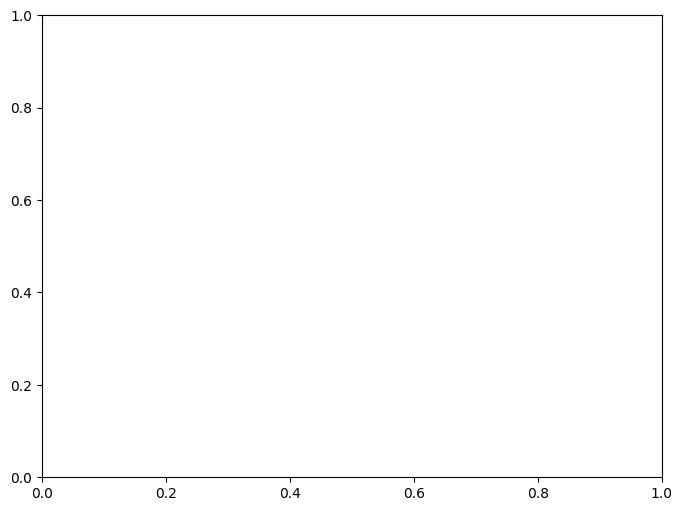

In [ ]:
# @title
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Определение функции осциллятора Ван дер Поля
def van_der_pol(t, y, lmbda):
    x, x_dot = y
    return [x_dot, (lmbda - x ** 2) * x_dot - x]

# Начальные условия и параметры
t_span = (0, 50)
t_eval = np.linspace(*t_span, 1000)
y0 = [1.0, 0.0]  # начальные условия: [x(0), x'(0)]

fig, ax = plt.subplots(figsize=(8, 6))

def frame(w):
    ax.clear()
    lmbda = w
    sol = solve_ivp(van_der_pol, t_span, y0, args=(lmbda,), t_eval=t_eval)
    plot = ax.plot(sol.y[0], sol.y[1], label='Phase Portrait', color='b')
    ax.set_title(f'Phase Portrait of Van der Pol Oscillator (λ={lmbda})')
    ax.set_xlabel('x')
    ax.set_ylabel("x'")
    return [plot]

ani_vp = FuncAnimation(fig, frame, frames=np.linspace(-4, 4, 100), interval=50, blit=False)

plt.show()

In [ ]:
# @title
ani_vp.save("vp.gif")

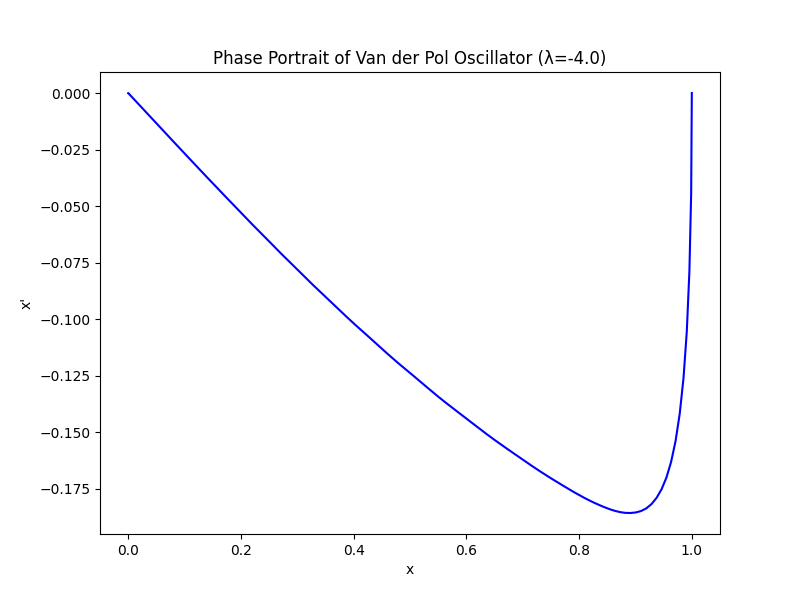

In [ ]:
# @title
Image(open('vp.gif','rb').read())

# Бифуркации фазовых траекторий

## **Глава 3: 16**

Изобразите бифуркационные диаграммы для бифуркаций:

Название | Уравнение бифуркации
--- | ---
седло-узел | $x'=λ-x^2$
транскритический | $x'=μx-x^2$
вилки | $x'=λx-x^3$

То же самое для обратных (субкритических) форм этих бифуркаций.


Решение в конце.

## **Глава 3: 28**

Для модели Рёсслера следующего вида:

$x'=-(y+z)$

$y'=x+ay$

$z'=bx+z(x-c)$

найдите связь между параметрами, соответствующую бифуркации Андронова—Хопфа неподвижной точки $x=y=z=0$.

*(Такой вариант модели Рёсслера рассмотрен в книге Г. Николиса и И. Пригожина «Познание сложного».)*


Решение в конце.

# Детерминированный хаос

## **Глава 4: 3(б,в,д)** *Исследование системы Лоренца*

a) Составьте анимационную программу, показывающую вращение жидкости в конвективной петле, описываемое уравнениями Лоренца при b=1. Распределение температуры кодируйте цветом. Пронаблюдайте качественно разные режимы динамики при различной интенсивности подогрева.


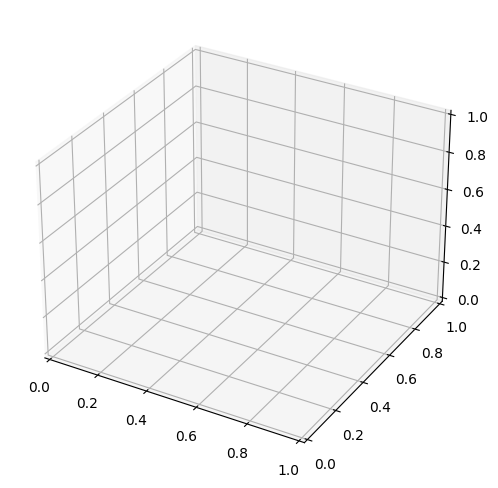

In [ ]:
# @title
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Параметры уравнения Лоренца
sigma = 10
rho = 28
beta = 1

# Функция, вычисляющая производные по каждой переменной
def lorenz_equations(state, t):
    x, y, z = state
    dxdt = sigma * (y - x)
    dydt = x * (rho - z) - y
    dzdt = x * y - beta * z
    return [dxdt, dydt, dzdt]

# Функция для численного решения уравнений Лоренца
def solve_lorenz(initial_state, t):
    from scipy.integrate import odeint
    sol = odeint(lorenz_equations, initial_state, t)
    return sol

# Начальные условия и параметры интегрирования
initial_state = [1, 1, 1]
t = np.linspace(0, 50, 5000)

# Решение уравнений Лоренца
sol = solve_lorenz(initial_state, t)

# Визуализация решения
fig = plt.figure(figsize=(8,6))
ax = plt.axes(projection='3d')

# Обновление фреймов
def update(frame):
    ax.clear()

    plot = ax.plot(sol[:, 0], sol[:, 1], sol[:, 2], color='b', alpha=0.7, linewidth=0.7)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_title('Траектория в пространстве Лоренца')
    return plot

In [ ]:
# @title
ani_l_a = animation.FuncAnimation(fig, update, frames=100, blit=False, repeat=True)

In [ ]:
# @title
ani_l_a


б) Составьте программу численного решения уравнений Лоренца

$x'=σ(y-x)$

$y'=rx-y-xz$

$z'=xy-bz$

стандартным методом Рунге—Кутта четвертого порядка.

Постройте графики временной зависимости для динамических переменных от времени и проекции фазового портрета на плоскости (x,y), (y,z), (z,x).

Используйте «классический» набор параметров: r = 28, b == 8/3, σ = 10.

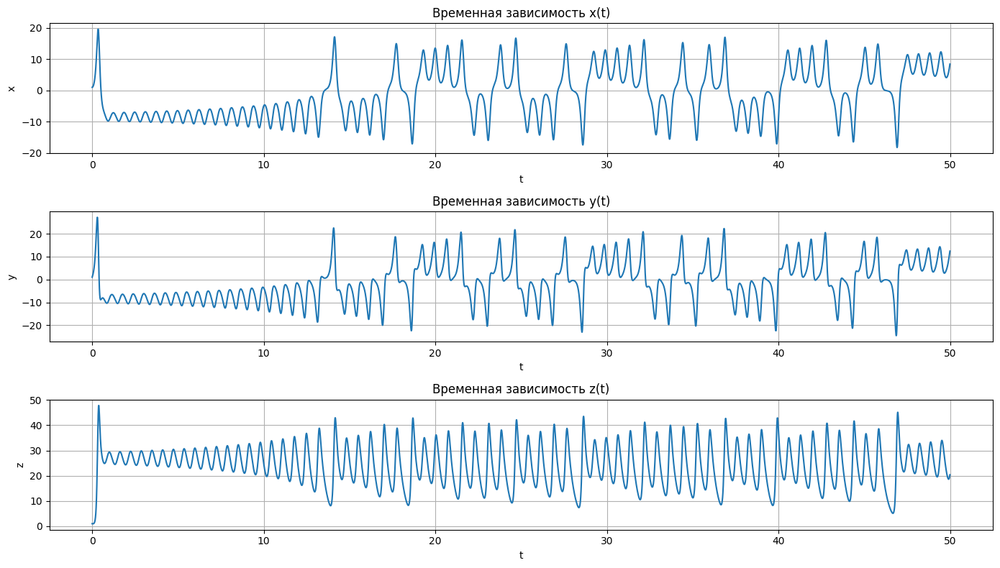

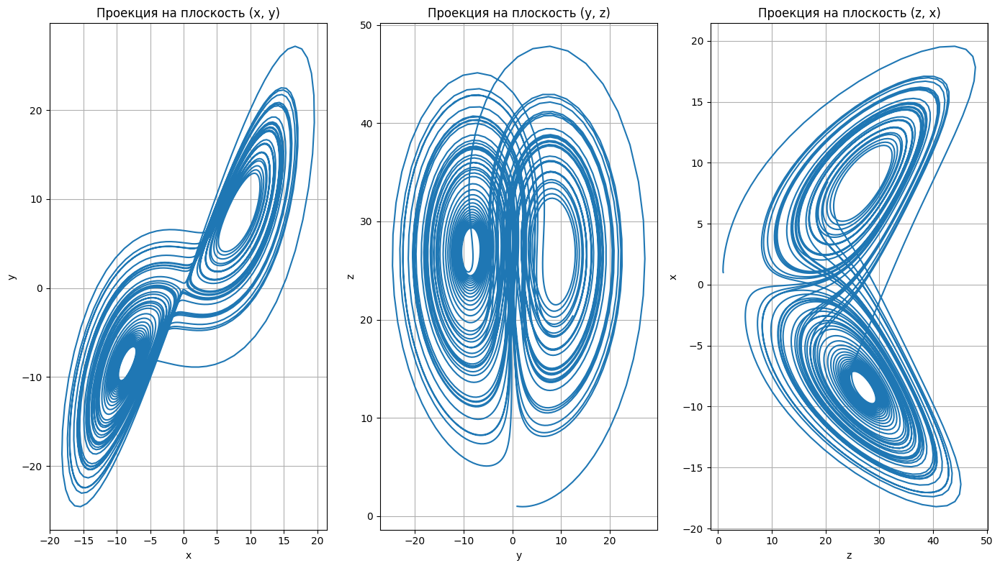

In [ ]:
# @title
import numpy as np
import matplotlib.pyplot as plt

# Параметры уравнения Лоренца
sigma = 10
rho = 28
beta = 8/3

# Уравнения Лоренца
def lorenz_equations(state, t, sigma, rho, beta):
    x, y, z = state
    dxdt = sigma * (y - x)
    dydt = x * (rho - z) - y
    dzdt = x * y - beta * z
    return np.array([dxdt, dydt, dzdt])

# Метод Рунге-Кутта 4-го порядка
def runge_kutta_4(f, state, t, dt, sigma, rho, beta):
    k1 = f(state, t, sigma, rho, beta)
    k2 = f(state + dt/2 * k1, t + dt/2, sigma, rho, beta)
    k3 = f(state + dt/2 * k2, t + dt/2, sigma, rho, beta)
    k4 = f(state + dt * k3, t + dt, sigma, rho, beta)
    return state + dt/6 * (k1 + 2*k2 + 2*k3 + k4)

# Начальные условия и параметры интегрирования
initial_state = np.array([1, 1, 1])
t_start = 0
t_end = 50
dt = 0.01
t = np.arange(t_start, t_end, dt)

# Решение уравнений Лоренца
num_steps = len(t)
sol = np.zeros((num_steps, 3))
sol[0] = initial_state

for i in range(1, num_steps):
    sol[i] = runge_kutta_4(lorenz_equations, sol[i-1], t[i-1], dt, sigma, rho, beta)

# Построение графиков временной зависимости
plt.figure(figsize=(14, 8))

plt.subplot(3, 1, 1)
plt.plot(t, sol[:, 0], label='x(t)')
plt.xlabel('t')
plt.ylabel('x')
plt.title('Временная зависимость x(t)')
plt.grid()

plt.subplot(3, 1, 2)
plt.plot(t, sol[:, 1], label='y(t)')
plt.xlabel('t')
plt.ylabel('y')
plt.title('Временная зависимость y(t)')
plt.grid()

plt.subplot(3, 1, 3)
plt.plot(t, sol[:, 2], label='z(t)')
plt.xlabel('t')
plt.ylabel('z')
plt.title('Временная зависимость z(t)')
plt.grid()

plt.tight_layout()
plt.show()

# Построение проекций фазового портрета
fig = plt.figure(figsize=(14, 8))

ax1 = fig.add_subplot(131)
ax1.plot(sol[:, 0], sol[:, 1])
ax1.set_xlabel('x')
ax1.set_ylabel('y')
ax1.set_title('Проекция на плоскость (x, y)')
ax1.grid()

ax2 = fig.add_subplot(132)
ax2.plot(sol[:, 1], sol[:, 2])
ax2.set_xlabel('y')
ax2.set_ylabel('z')
ax2.set_title('Проекция на плоскость (y, z)')
ax2.grid()

ax3 = fig.add_subplot(133)
ax3.plot(sol[:, 2], sol[:, 0])
ax3.set_xlabel('z')
ax3.set_ylabel('x')
ax3.set_title('Проекция на плоскость (z, x)')
ax3.grid()

plt.tight_layout()
plt.show()

в) Запуская траекторию системы Лоренца из окрестности начала координат, отследите ее поведение при r = 5, 12, 13.927, 20, 24.06, 28. Остальные параметры стандартные: σ = 10, b = 8/3. Обсудите результаты в контексте бифуркационного анализа.

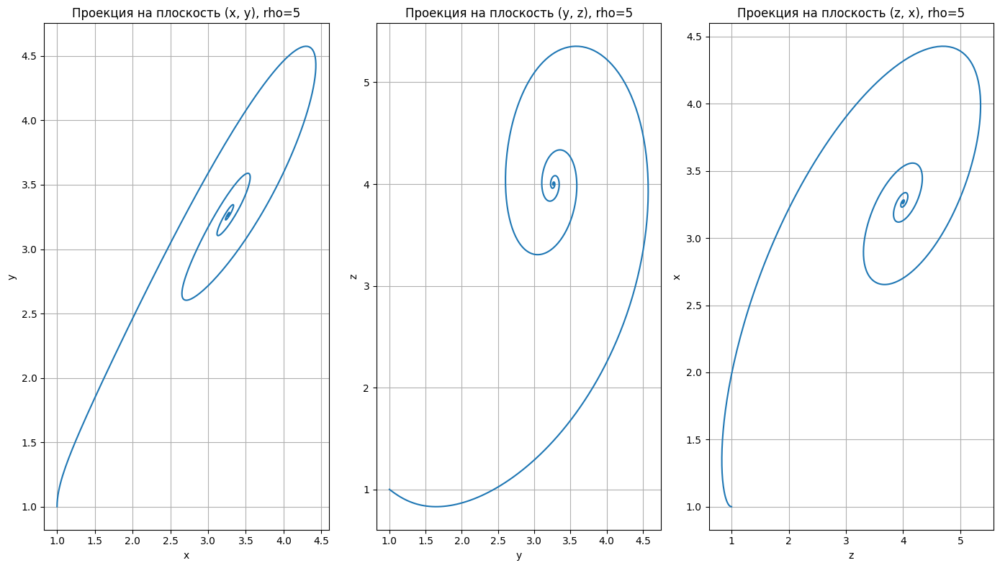

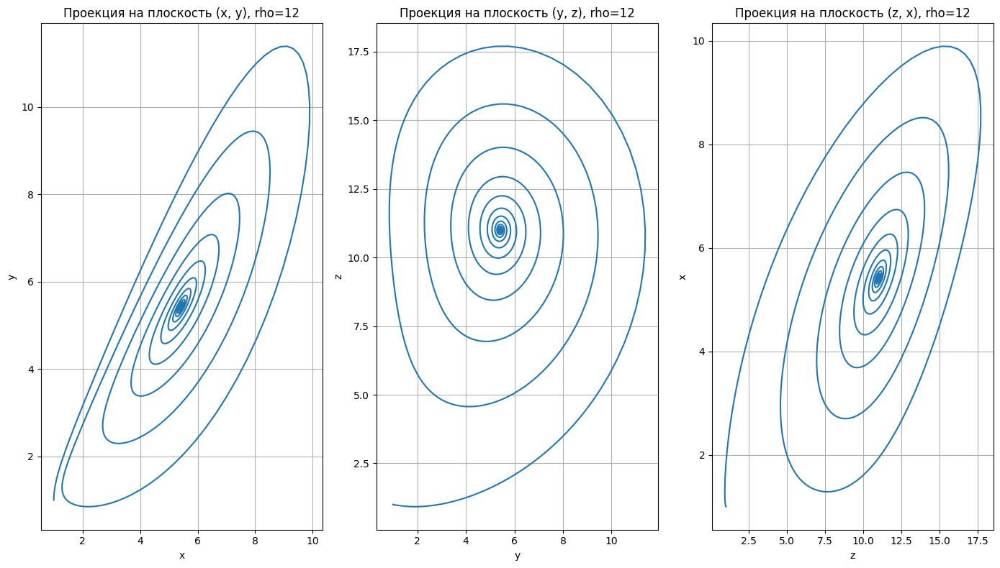

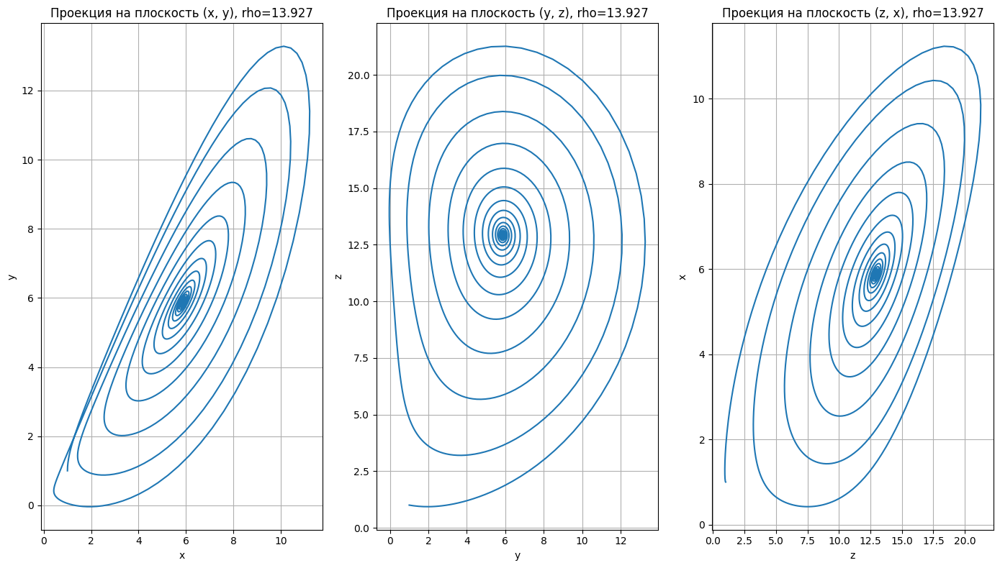

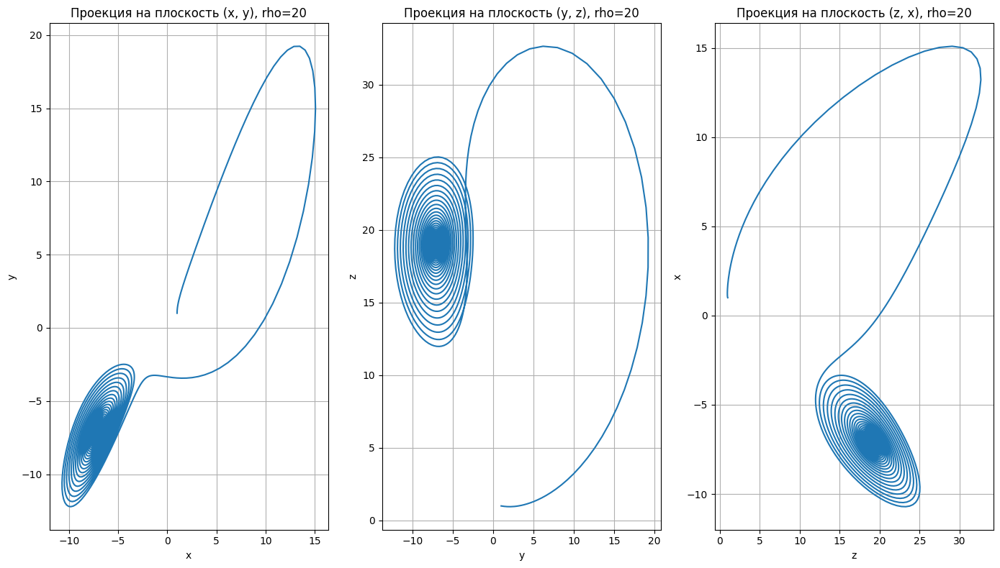

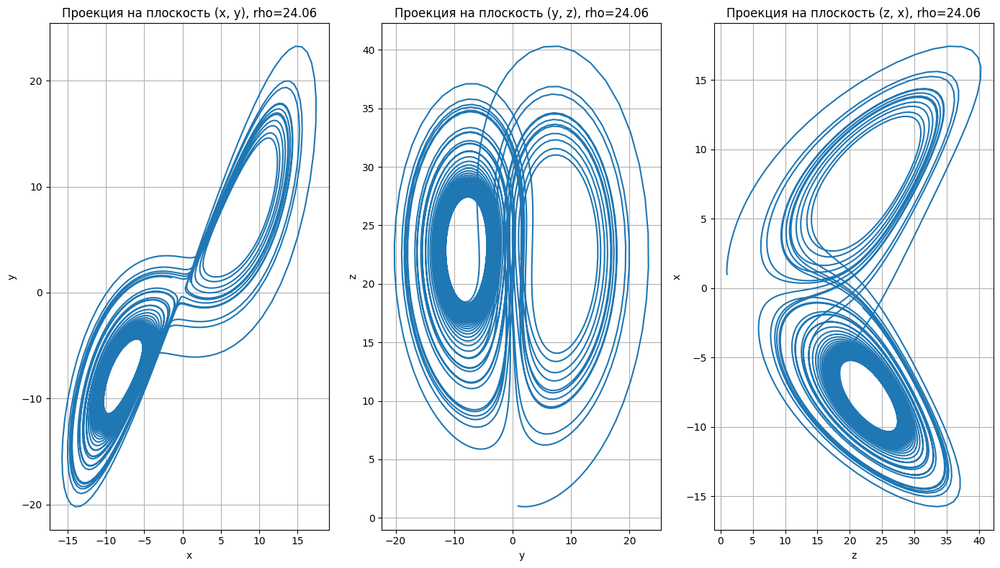

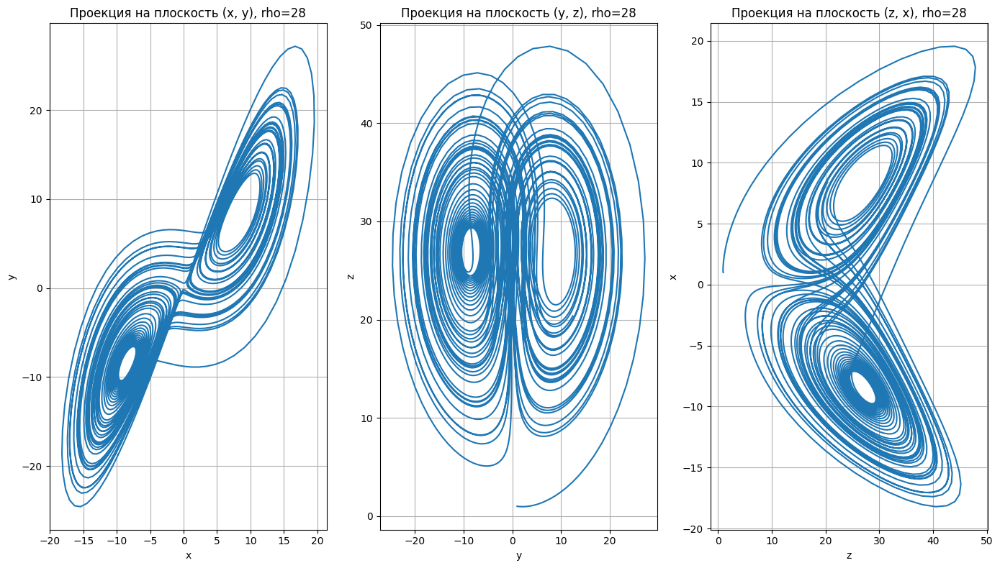

In [ ]:
# @title
import numpy as np
import matplotlib.pyplot as plt

# Параметры уравнения Лоренца
sigma = 10
beta = 8/3

# Уравнения Лоренца
def lorenz_equations(state, t, sigma, rho, beta):
    x, y, z = state
    dxdt = sigma * (y - x)
    dydt = x * (rho - z) - y
    dzdt = x * y - beta * z
    return np.array([dxdt, dydt, dzdt])

# Метод Рунге-Кутта 4-го порядка
def runge_kutta_4(f, state, t, dt, sigma, rho, beta):
    k1 = f(state, t, sigma, rho, beta)
    k2 = f(state + dt/2 * k1, t + dt/2, sigma, rho, beta)
    k3 = f(state + dt/2 * k2, t + dt/2, sigma, rho, beta)
    k4 = f(state + dt * k3, t + dt, sigma, rho, beta)
    return state + dt/6 * (k1 + 2*k2 + 2*k3 + k4)

# Начальные условия и параметры интегрирования
initial_state = np.array([1, 1, 1])
t_start = 0
t_end = 50
dt = 0.01
t = np.arange(t_start, t_end, dt)

# Значения параметра rho для анализа бифуркаций
r_values = [5, 12, 13.927, 20, 24.06, 28]

# Построение графиков для разных значений rho
for rho in r_values:
    # Решение уравнений Лоренца
    num_steps = len(t)
    sol = np.zeros((num_steps, 3))
    sol[0] = initial_state

    for i in range(1, num_steps):
        sol[i] = runge_kutta_4(lorenz_equations, sol[i-1], t[i-1], dt, sigma, rho, beta)

    # Построение фазового портрета
    fig = plt.figure(figsize=(14, 8))
    ax1 = fig.add_subplot(131)
    ax1.plot(sol[:, 0], sol[:, 1])
    ax1.set_xlabel('x')
    ax1.set_ylabel('y')
    ax1.set_title(f'Проекция на плоскость (x, y), rho={rho}')
    ax1.grid()

    ax2 = fig.add_subplot(132)
    ax2.plot(sol[:, 1], sol[:, 2])
    ax2.set_xlabel('y')
    ax2.set_ylabel('z')
    ax2.set_title(f'Проекция на плоскость (y, z), rho={rho}')
    ax2.grid()

    ax3 = fig.add_subplot(133)
    ax3.plot(sol[:, 2], sol[:, 0])
    ax3.set_xlabel('z')
    ax3.set_ylabel('x')
    ax3.set_title(f'Проекция на плоскость (z, x), rho={rho}')
    ax3.grid()

    plt.tight_layout()
    plt.show()

г)  Пронаблюдайте переход к хаосу через удвоения периода в системе Лоренца. Для этого постройте «бифуркационное дерево» на плоскости (r,z), где по оси ординат откладывайте максимумы z. Положите σ = 10, b = 8/3, а интервал изменения параметра r от 98 до 100. (Проверьте, обеспечивает ли выбранный шаг интегрирования достаточную точность!)

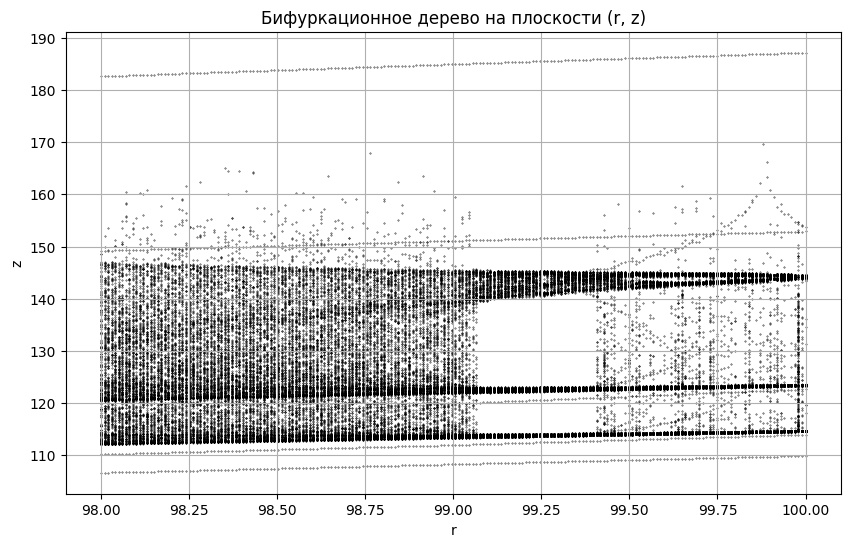

In [ ]:
# @title
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import odeint

# Параметры уравнения Лоренца
sigma = 10
beta = 8/3

# Уравнения Лоренца
def lorenz_equations(state, t, sigma, rho, beta):
    x, y, z = state
    dxdt = sigma * (y - x)
    dydt = x * (rho - z) - y
    dzdt = x * y - beta * z
    return [dxdt, dydt, dzdt]

# Функция для численного решения уравнений Лоренца
def solve_lorenz(initial_state, t, sigma, rho, beta):
    sol = odeint(lorenz_equations, initial_state, t, args=(sigma, rho, beta))
    return sol

# Начальные условия и параметры интегрирования
initial_state = [1, 1, 1]
t_start = 0
t_end = 100
dt = 0.01
t = np.arange(t_start, t_end, dt)

# Диапазон значений параметра r
r_values = np.linspace(98, 100, 200)

# Сбор данных для бифуркационного дерева
bifurcation_data = []

for rho in r_values:
    sol = solve_lorenz(initial_state, t, sigma, rho, beta)
    z = sol[:, 2]

    # Найти максимумы z
    maxima_z = []
    for i in range(1, len(z) - 1):
        if z[i - 1] < z[i] and z[i] > z[i + 1]:
            maxima_z.append(z[i])

    # Учитываем только последние 1000 максимумов, чтобы избежать переходных процессов
    if len(maxima_z) > 1000:
        maxima_z = maxima_z[-1000:]

    # Добавляем данные в бифуркационное дерево
    for mz in maxima_z:
        bifurcation_data.append((rho, mz))

# Преобразование данных в numpy массив для удобства
bifurcation_data = np.array(bifurcation_data)

# Построение бифуркационного дерева
plt.figure(figsize=(10, 6))
plt.scatter(bifurcation_data[:, 0], bifurcation_data[:, 1], s=0.1, color='black')
plt.xlabel('r')
plt.ylabel('z')
plt.title('Бифуркационное дерево на плоскости (r, z)')
plt.grid(True)
plt.show()




д) Пронаблюдайте переход к хаосу через перемежаемость в системе Лоренца. Для этого постройте графики зависимости z(t) в интервале времени порядка 200 для системы Лоренца при σ = 10, b = 8/3 и значениях r = 166, 166.15, 166.3. Получите для указанных параметров также фазовые портреты аттрактора в проекциях на три координатные плоскости

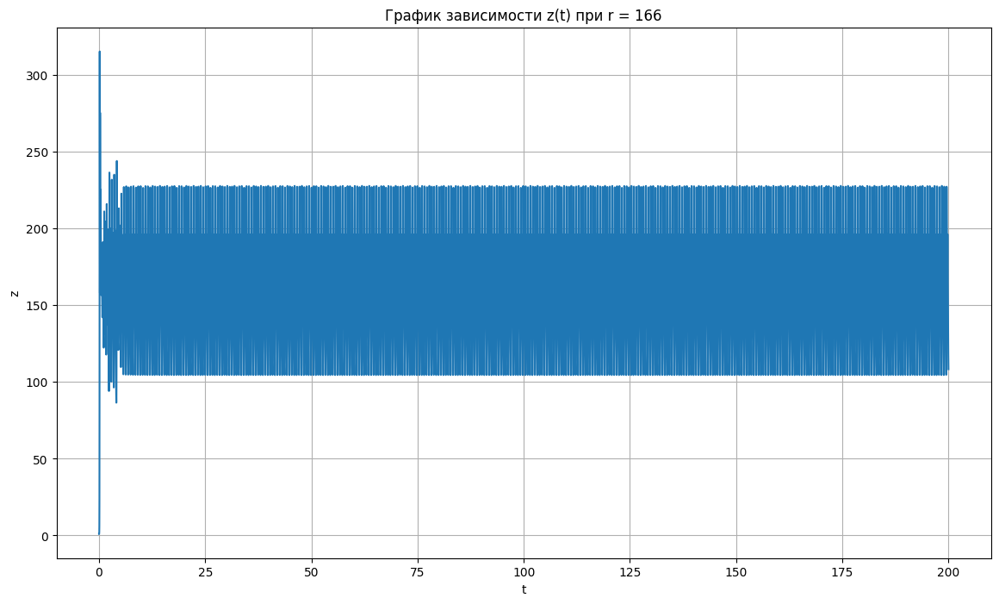

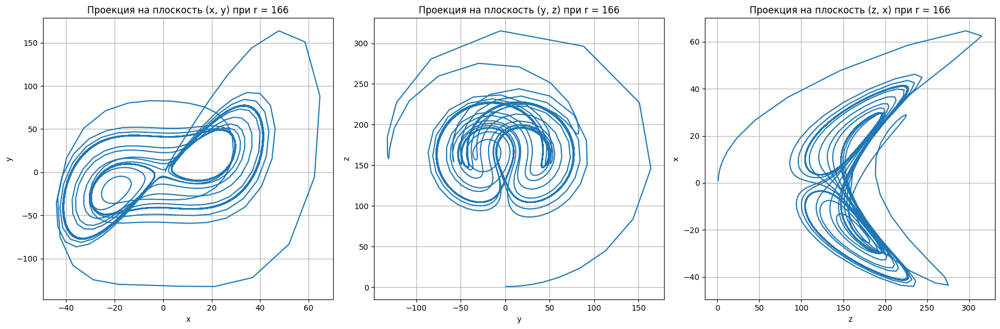

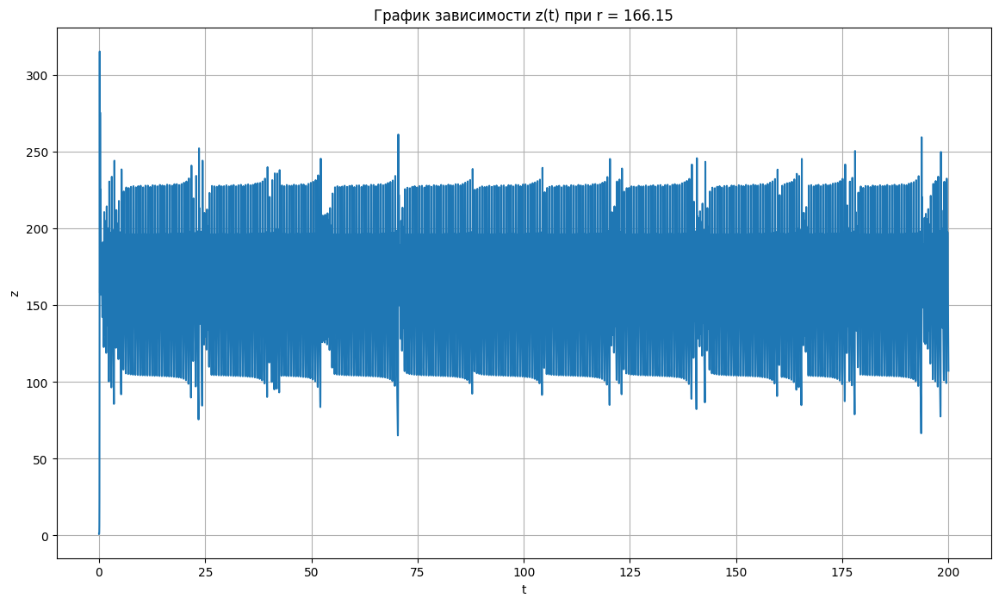

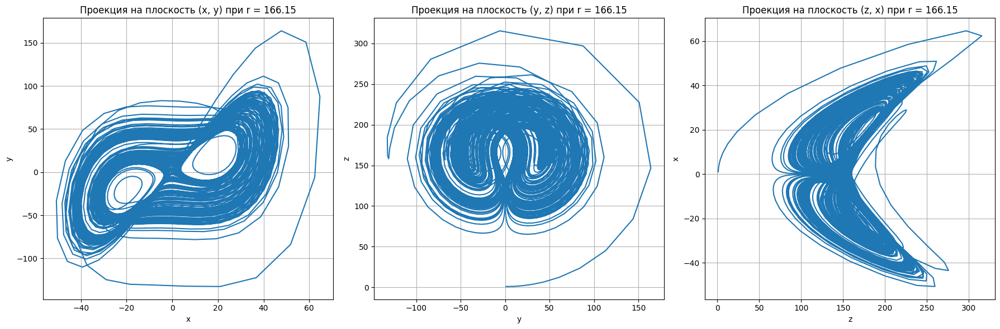

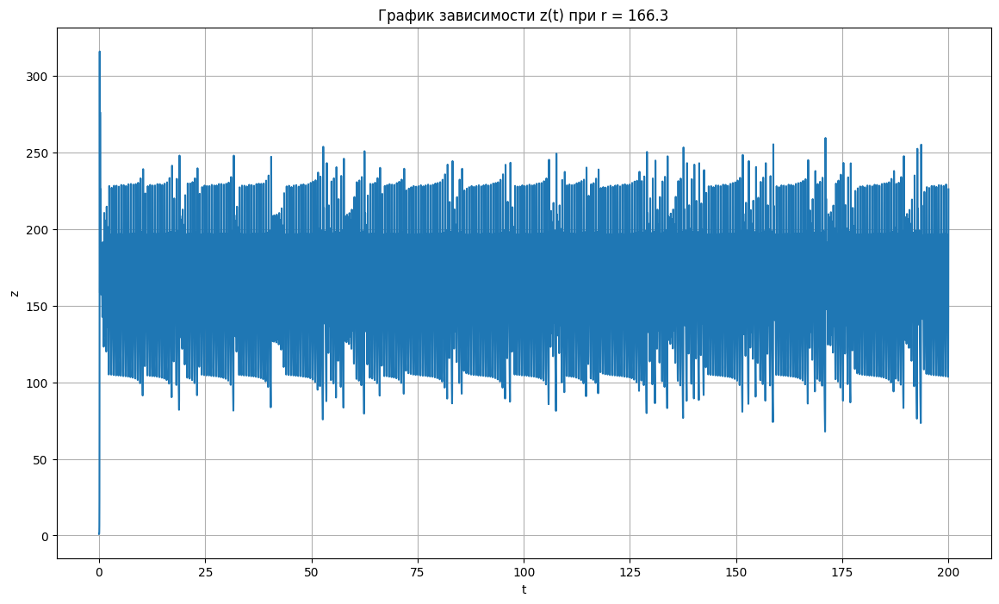

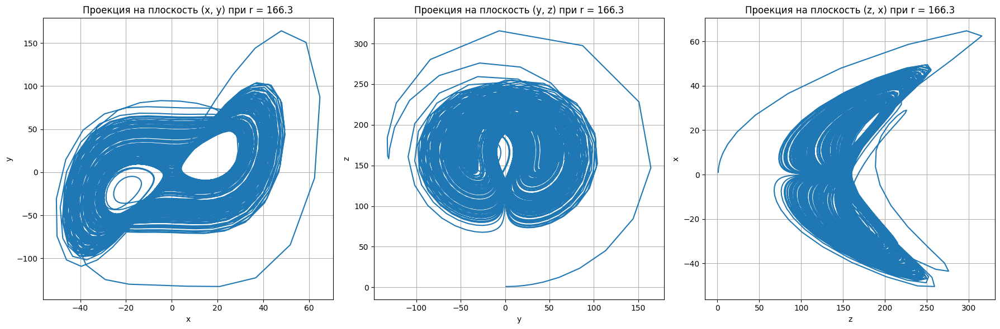

In [ ]:
# @title
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import odeint

# Параметры уравнения Лоренца
sigma = 10
beta = 8/3

# Уравнения Лоренца
def lorenz_equations(state, t, sigma, rho, beta):
    x, y, z = state
    dxdt = sigma * (y - x)
    dydt = x * (rho - z) - y
    dzdt = x * y - beta * z
    return [dxdt, dydt, dzdt]

# Функция для численного решения уравнений Лоренца
def solve_lorenz(initial_state, t, sigma, rho, beta):
    sol = odeint(lorenz_equations, initial_state, t, args=(sigma, rho, beta))
    return sol

# Начальные условия и параметры интегрирования
initial_state = [1, 1, 1]
t_start = 0
t_end = 200
dt = 0.01
t = np.arange(t_start, t_end, dt)

# Значения параметра r для анализа перемежаемости
r_values = [166, 166.15, 166.3]

for rho in r_values:
    # Решение уравнений Лоренца
    sol = solve_lorenz(initial_state, t, sigma, rho, beta)

    # Построение графика z(t)
    plt.figure(figsize=(14, 8))
    plt.plot(t, sol[:, 2])
    plt.xlabel('t')
    plt.ylabel('z')
    plt.title(f'График зависимости z(t) при r = {rho}')
    plt.grid(True)
    plt.show()

    # Построение фазового портрета
    fig = plt.figure(figsize=(18, 6))

    ax1 = fig.add_subplot(131)
    ax1.plot(sol[:, 0], sol[:, 1])
    ax1.set_xlabel('x')
    ax1.set_ylabel('y')
    ax1.set_title(f'Проекция на плоскость (x, y) при r = {rho}')
    ax1.grid()

    ax2 = fig.add_subplot(132)
    ax2.plot(sol[:, 1], sol[:, 2])
    ax2.set_xlabel('y')
    ax2.set_ylabel('z')
    ax2.set_title(f'Проекция на плоскость (y, z) при r = {rho}')
    ax2.grid()

    ax3 = fig.add_subplot(133)
    ax3.plot(sol[:, 2], sol[:, 0])
    ax3.set_xlabel('z')
    ax3.set_ylabel('x')
    ax3.set_title(f'Проекция на плоскость (z, x) при r = {rho}')
    ax3.grid()

    plt.tight_layout()
    plt.show()

## **Глава 4: 32**

Подготовьте несколько анимационных программ, иллюстрирующих явления нелинейной динамики (различные бильярды, «прыгающий шарик», двойной маятник, система Лоренца и т.д.). Сделайте программы удобными для демонстраций и пользования.


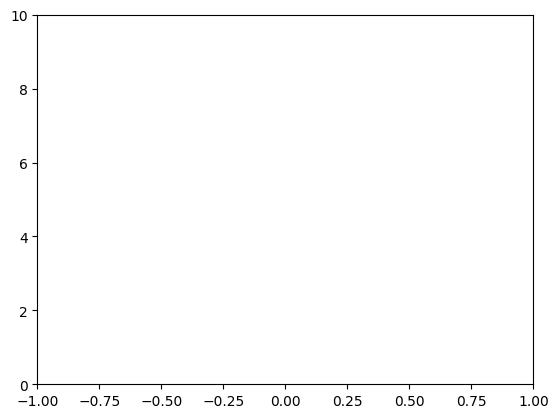

In [ ]:
# @title
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from ipywidgets import interact, widgets

def update(frame):
    global x, y, vy, g, bounce_height
    y = y + vy * dt - 0.5 * g * dt**2
    vy = vy - g * dt
    if y < bounce_height:
        vy = -vy * 0.9
        y = bounce_height
    ball.set_data(x, y)
    return ball,

def init():
    ball.set_data([], [])
    return ball,

# Parameters
x = 0
y = 0
vy = 10
g = 9.8
bounce_height = 0
dt = 0.01
tmax = 10

# Create figure and axis
fig, ax = plt.subplots()
ax.set_xlim(-1, 1)
ax.set_ylim(0, 10)
ball, = ax.plot([], [], 'bo', ms=10)

# Create animation
ani_ball = FuncAnimation(fig, update, frames=np.arange(0, tmax, dt), init_func=init, blit=True)

# Show animation
plt.show()


In [ ]:
# @title
ani_ball.save("ball.gif")

<ipython-input-13-1e3ca1de32e0>:14: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  ball.set_data(x, y)


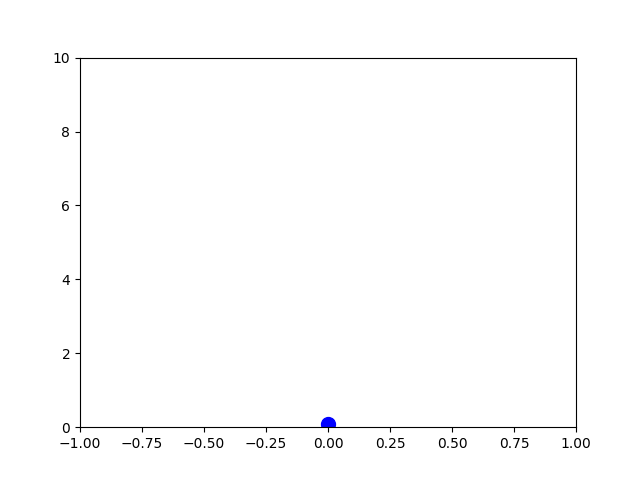

In [ ]:
Image(open('ball.gif','rb').read())